# Using Faster-RCNN and SSD in Tensorflow to detect birds from images
---
*Last Updated 19 November 2019*   
OS: Windows 10  
GPU: NVIDIA GeForce GTX 970M  
Requirements: Before running, need to install Visual Studio 2015 with Windows SDK, CUDA 10.0, cuDNN 7.6.0   
Tensorflow-gpu version 2.0

## Install
---
This tutorial is modified from the Tensorflow Object Detection API Tutorial at https://github.com/tensorflow/models/tree/master/research/object_detection. Before running this notebook for object detection, install Visual Studio 2015 with Windows SDK, CUDA 10.0, cuDNN 7.6.0, pycocotools via COCOAPI, Tensorflow Object Detection API, Google Protobuf 3.4.0, and modify system path variables accordingly. For detailed instructions on installation, refer to the Tensorflow Object Detection API Tutorial and the documentation at https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/install.html#tensorflow-models-installation. To install Google Protobuf for Windows and change your path variables, see Steps 7-10 here https://medium.com/@marklabinski/installing-tensorflow-object-detection-api-on-windows-10-7a4eb83e1e7b.

Note: Be sure to use tensorflow-gpu==2.0 (note: have also gotten most but not all parts working with tensorflow-gpu==1.15, if using v1.15 add tf.compat.v1 in front of tf functions)

In [ ]:
# install tensorflow-gpu version 2.0
pip install tensorflow-gpu==2.0 --user 

## Imports
---
Set your working directory to 'models\research\object_detection'. These folders were downloaded with the Tensorflow Object Detection API.

In [1]:
import os
import pathlib


if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models
    
os.getcwd()

'C:\\Users\\kwolcott\\Documents\\python\\image_recognition\\tf_imgdetect\\venv'

In [2]:
import numpy as np # numpy==1.16.4
import csv
import os
import tensorflow as tf # tensorflow-gpu==2.0
import matplotlib
import time

from PIL import Image
from IPython.display import display

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [4]:
# patch tf1 into `utils.ops` if using tf==1.15
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

# Model preparation 
---

First, download a model from the tensorflow model zoo here https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md, move it to the current working directory and un-tar/unzip it.

Used here: Faster RCNN Resnet 50 trained on COCO (89 ms, 30 mAP), SSD Resnet 50 trained on COCO (76 ms, 35 mAP)

## Loader

In [5]:
# Insert the model name
# Used here: faster_rcnn_resnet50_coco_2018_01_28 or ssd_resnet50_v1_fpn_shared_box_predictor_640x640_coco14_sync_2018_07_03
model_name = 'faster_rcnn_resnet50_coco_2018_01_28' 
model_dir = os.path.join('models/research/object_detection/', model_name, 'saved_model')
model_dir = os.path.normpath(model_dir)
print(model_dir)

# load model and signatures
model = tf.saved_model.load(str(model_dir), None)
model = model.signatures['serving_default']
detection_model = model

models\research\object_detection\faster_rcnn_resnet50_coco_2018_01_28\saved_model
INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [6]:
# Check the model's input signature, it expects a batch of 3-color images of type uint8
print(detection_model.inputs)

# And retuns several outputs
detection_model.output_dtypes
detection_model.output_shapes

[<tf.Tensor 'image_tensor:0' shape=(None, None, None, 3) dtype=uint8>]


## Load in label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [9]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'models/research/object_detection/data/mscoco_label_map.pbtxt'
PATH_TO_CKPT = os.path.join('models/research/object_detection/', model_name, 'frozen_inference_graph.pb')
PATH_TO_CKPT = os.path.normpath(PATH_TO_CKPT)

NUM_CLASSES = 90

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

## Load in test images
---
You can also move your own image files into 'test_images/'.

In [10]:
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('models/research/object_detection/test_images')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[WindowsPath('models/research/object_detection/test_images/542.10578857864.jpg'),
 WindowsPath('models/research/object_detection/test_images/542.15445377044.jpg'),
 WindowsPath('models/research/object_detection/test_images/542.4801468374.jpg'),
 WindowsPath('models/research/object_detection/test_images/542.7816025222.jpg')]

## Define object detection functions
The first function "run_inference_for_single_image" reads in the image and convert it to a format that the program can detect objects from using on pre-trained models. 

In [11]:
def run_inference_for_single_image(detection_model, image):
  image_np = np.array(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image_np)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  output_dict = detection_model(input_tensor)

  # all outputs are batches tensors.
  # convert to numpy arrays, and take index [0] to remove the batch dimension.
  # we're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

The second function "show_inference" displays the results of detection and writes the bounding box values to 'sample_crops_tf.tsv'. You can adjust the parameters so that bounding boxes are only shown for certain confidence or class values. Here boxes are shown when confidence > 0.6 and object class is 'bird' (class '16').

In [12]:
def show_inference(detection_model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  
  # actual detection.
  output_dict = run_inference_for_single_image(detection_model, image_np)
  
  # name parts of tensor, set score threshold
  boxes = np.squeeze(output_dict['detection_boxes'])
  max_boxes_to_draw = boxes.shape[0]
  scores = np.squeeze(output_dict['detection_scores'])
  classes = np.squeeze(output_dict['detection_classes'])
  min_score_thresh = .6
    
  # eliminate not_birds from detection results 
  # bird class = 16, for all not_birds set score < min_score_thresh
  not_bird_elements = np.where(classes != 16)
  for i in not_bird_elements:
    scores[i] = 0.01

  # eliminate overlapping boxes/detections using non_max_suppression 
  selected_indices = tf.image.non_max_suppression(
    boxes, scores, score_threshold=min_score_thresh, max_output_size=1, iou_threshold=0.5) # selects the box/detection with highest core
  selected_box = tf.constant(tf.gather(boxes, selected_indices))

  # write results of detection to tsv
  with open('models/research/object_detection/test_images/sample_crops_tf.tsv', 'a') as out_file:
    tsv_writer = csv.writer(out_file, delimiter='\t')
    im_width, im_height, channels = np.array(image_np).shape
    ymin, xmin, ymax, xmax = np.squeeze(np.array(selected_box))
    crop_width = (xmax-xmin) * im_width
    crop_height = (ymax-ymin) * im_height
    tsv_writer.writerow([os.path.splitext((os.path.basename(image_path)))[0], im_height, im_width, 
                            xmin * im_width, ymin * im_height, crop_height, crop_width])
    
  # visualize the results of detection on images
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      np.array(selected_box), # only visualize the box resulting from non_max_suppression
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True, # absolute pixel values (FALSE) or relative corrected by img width & height (TRUE)
      line_thickness=8, min_score_thresh=min_score_thresh) 
        
  display(Image.fromarray(image_np)) # delete this when running on cluster

## Run detector for all test images
---
Run the image detector for all images within 'test_images/'. Results are plotted below and include the image with bounding box, class type, and confidence score. Inference times are printed below images. The bounding box coordinates are also written to 'sample_crops_tf.tsv'. 

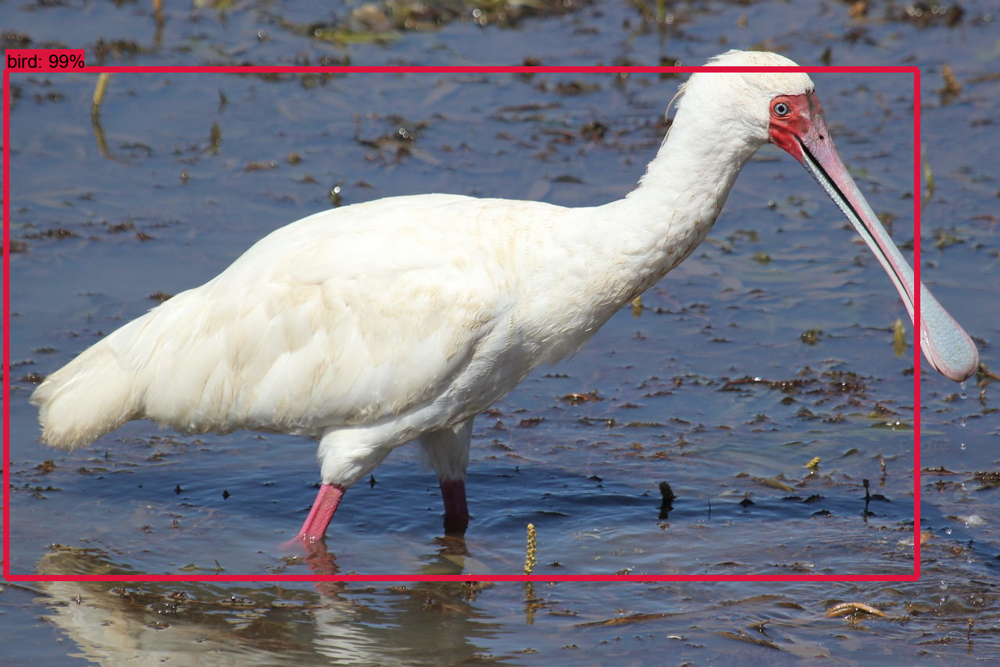

Inference time: 2.984483242034912


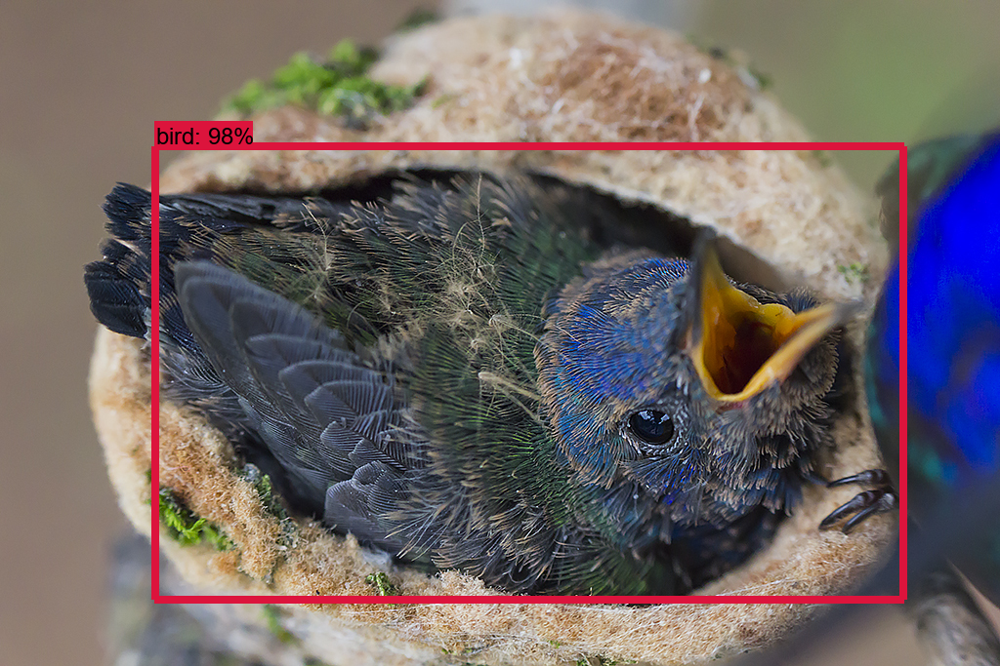

Inference time: 2.475274085998535


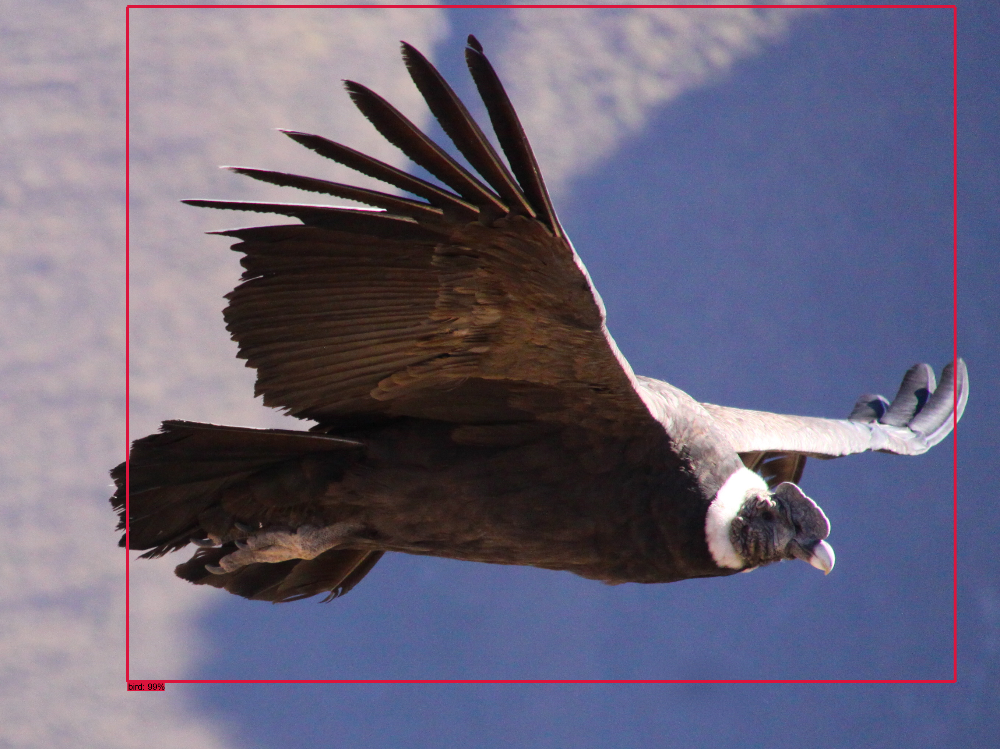

Inference time: 6.762137413024902


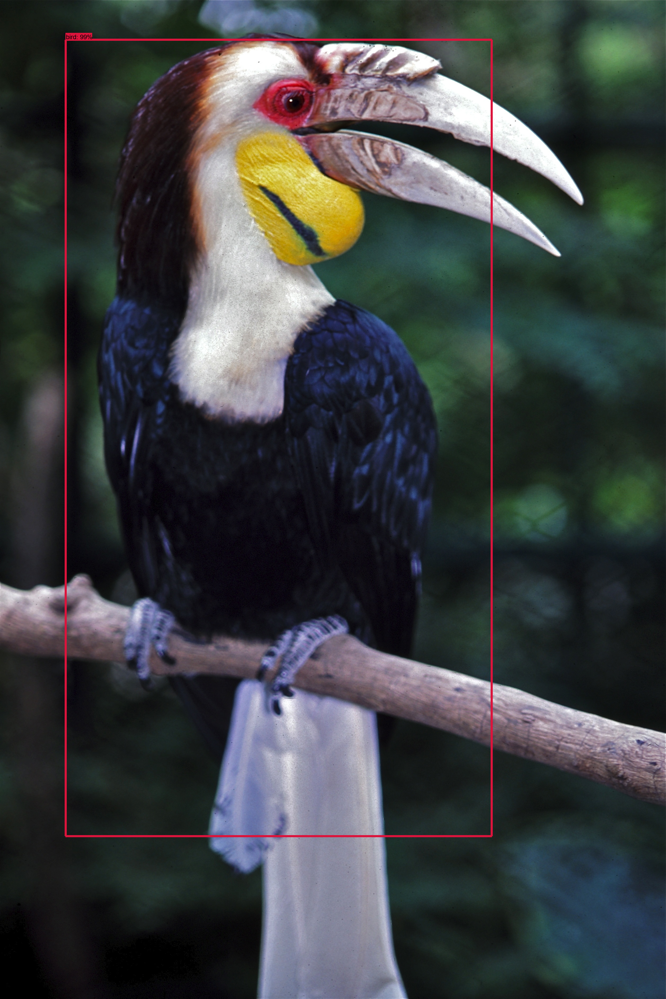

Inference time: 9.45681643486023


In [14]:
for image_path in TEST_IMAGE_PATHS:
  start_time = time.time()
  show_inference(detection_model, image_path)
  end_time = time.time()
  print("Inference time:", end_time-start_time)